In [ ]:
import pandas as pd
import xml.etree.ElementTree as ET
import glob
import os


path='/content/est'

os.chdir(path)

elements = ['Image','height','width','depth','coin_1','coin_2','coin_3','coin_4']

df=pd.DataFrame(columns=elements)

# Initialize empty lists to store coin information
coin_names = []
coin_values = {}


# Iterate over XML files in the directory
for xml_file in glob.glob('*.xml'):
    if xml_file.endswith('.xml'):
        # Parse the XML file
        tree = ET.parse(os.path.join(path, xml_file))
        root = tree.getroot()

        # Extract the annotation file name
        file_name = root.find('filename').text

        # Extract size information
        width = int(root.find('size/width').text)
        height = int(root.find('size/height').text)
        depth = int(root.find('size/depth').text)


        # Iterate over the 'object' elements
        for obj in root.iter('object'):
            # Extract the coin name
            coin_name = obj.find('name').text

            # Extract the coin value (xmin, ymin, xmax, ymax)
            bbox = obj.find('bndbox')
            xmin = int(bbox.find('xmin').text)
            ymin = int(bbox.find('ymin').text)
            xmax = int(bbox.find('xmax').text)
            ymax = int(bbox.find('ymax').text)

            # Store the coin value in the dictionary
            coin_values[coin_name] = (xmin, xmax, ymin, ymax)

        tmp_df=pd.DataFrame([coin_values], columns=['Image','height','width','depth'] + list(coin_values.keys()))
        # Set the 'filename' column value
        tmp_df['Image'] = file_name
        tmp_df['height']=height
        tmp_df['width']=width
        tmp_df['depth']=depth
        # Append the data to the DataFrame
        df = pd.concat([df,tmp_df], ignore_index=True)



# Print the DataFrame
df.head

<bound method NDFrame.head of      Image height width depth                coin_1                coin_2  \
0   17.jpg    448   448     3    (66, 66, 262, 262)    (19, 19, 171, 171)   
1   28.jpg    448   448     3    (77, 77, 264, 264)    (22, 22, 151, 151)   
2   29.jpg    448   448     3    (68, 68, 291, 291)    (29, 29, 195, 195)   
3    5.jpg    448   448     3  (149, 149, 299, 299)  (112, 112, 230, 230)   
4   14.jpg    448   448     3  (100, 100, 284, 284)    (42, 42, 169, 169)   
5   22.jpg    448   448     3  (113, 113, 265, 265)    (61, 61, 138, 138)   
6   21.jpg    448   448     3    (92, 92, 311, 311)    (44, 44, 247, 247)   
7    0.jpg    448   448     3      (77, 77, 73, 73)    (17, 17, 245, 245)   
8   35.jpg    448   448     3  (100, 100, 292, 292)    (59, 59, 231, 231)   
9   13.jpg    448   448     3    (74, 74, 277, 277)    (26, 26, 163, 163)   
10   9.jpg    448   448     3    (75, 75, 319, 319)    (39, 39, 216, 216)   
11  23.jpg    448   448     3    (22, 22, 325,

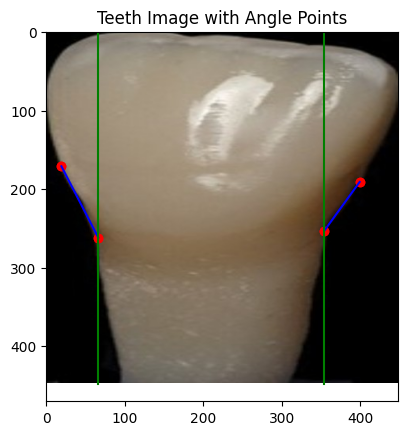

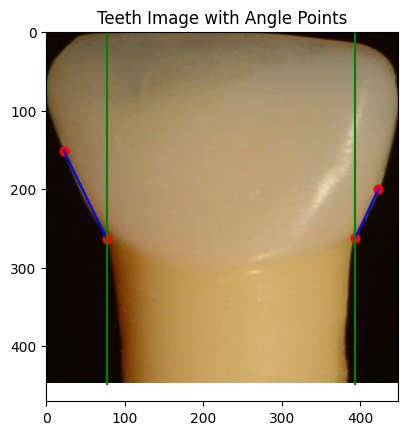

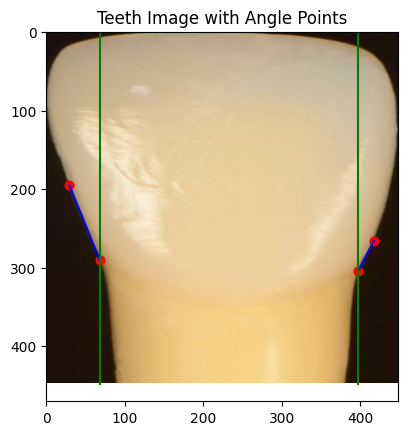

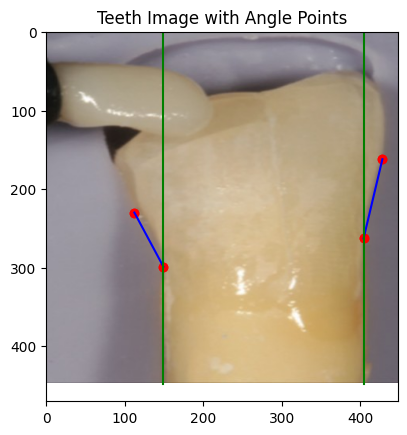

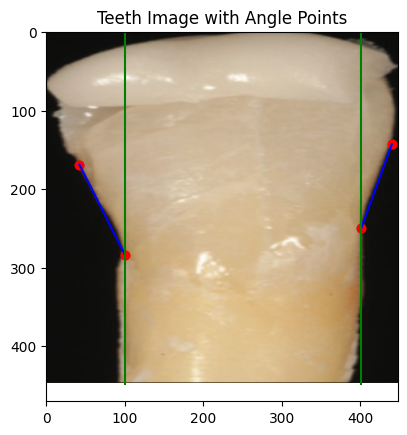

...

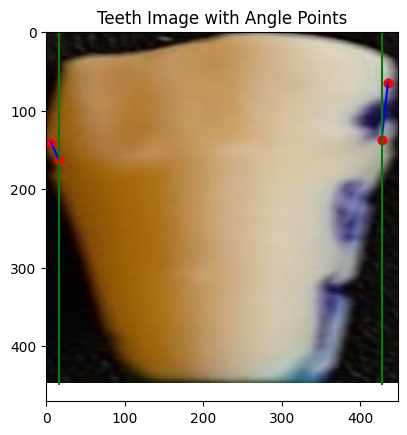

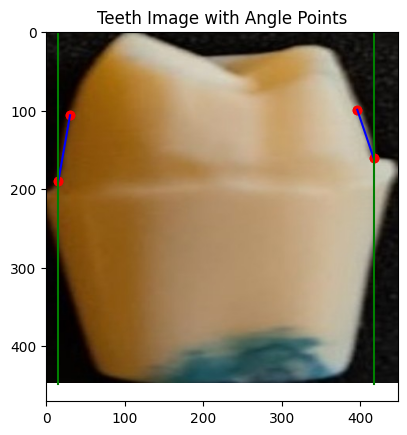

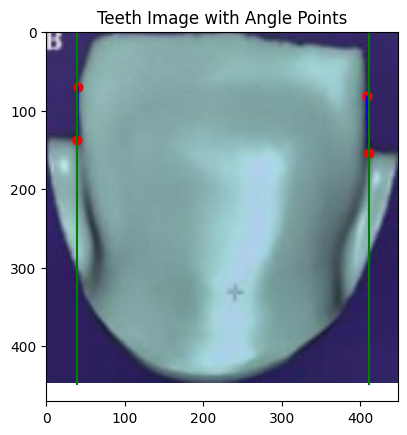

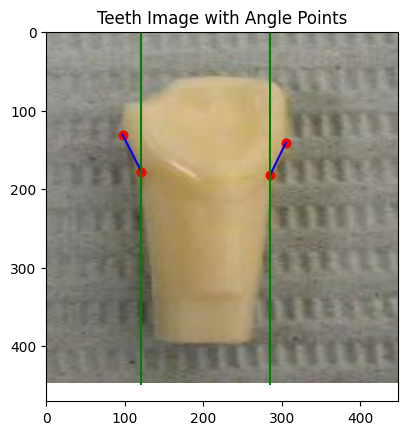

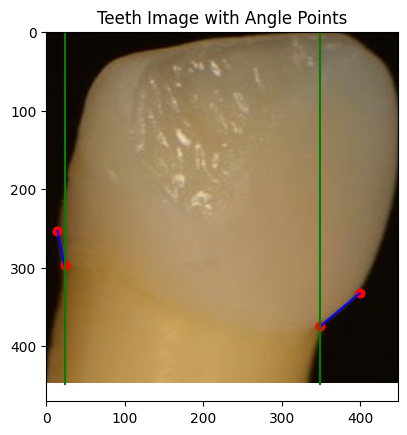

In [ ]:
import matplotlib.pyplot as plt
import cv2

images=df.Image

# Visualize images and their corresponding angle points
for i in range(len(images)):
    image = cv2.imread(images[i])
    angle = [df.loc[i,f'coin_{x}'] for x in range(1,5)]

    # Plot image with angle points
    plt.figure()
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    for p in angle:
        plt.scatter([p[0],p[1]], [p[2],p[3]], color='red')  # Plot the x and y coordinates separately
        # Draw a line between the two points
        plt.plot()
    # Draw lines between the angle points
    for j in [0,2]:
        x_coords = [angle[j][0], angle[j + 1][0]]  # x-coordinates
        y_coords = [angle[j][2], angle[j + 1][2]]  # y-coordinates
        x_c00rds = [angle[j][0],angle[j][0]]
        y_c00rds = [448,0]
        plt.plot(x_coords, y_coords, color='blue')
        plt.plot(x_c00rds, y_c00rds, color='green')
    plt.title('Teeth Image with Angle Points')
    plt.show()

In [ ]:
import cv2
import numpy as np
images = df.Image
output_folder='/content/est'
# Set the output folder to save the resulting images
os.makedirs(output_folder, exist_ok=True)

# Visualize images and their corresponding angle points
for i in range(len(images)):
    image = cv2.imread(images[i])
    mask = np.zeros_like(image)
    angle = [df.loc[i, f'coin_{x}'] for x in range(1, 5)]

    # Plot image with angle points and lines
    #for p in angle:
        #cv2.circle(mask, (p[0], p[2]), 3, (0, 0, 255), -1)  # Draw red circles at angle points

    # Draw lines between the angle points
    for j in [0, 2]:
        x_coords = [angle[j][0], angle[j + 1][0]]  # x-coordinates
        y_coords = [angle[j][2], angle[j + 1][2]]  # y-coordinates
        cv2.line(mask, (x_coords[0], y_coords[0]), (x_coords[1], y_coords[1]), (255, 255, 255), 2)  # Draw blue lines

    # Prepare mask for augmentation
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)  # Convert mask to grayscale
    mask = np.expand_dims(mask, axis=-1)  # Add channel dimension

    # Save the resulting image
    output_path = os.path.join(output_folder, f'mask_{images[i][:-4]}.jpg')
    cv2.imwrite(output_path, mask)


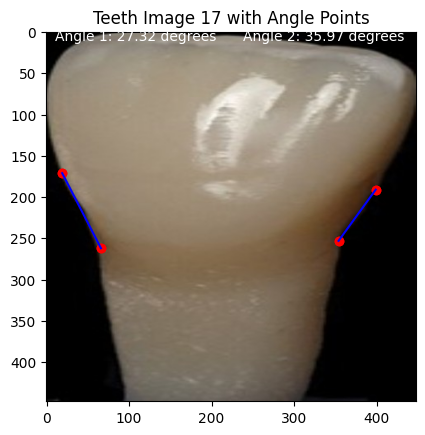

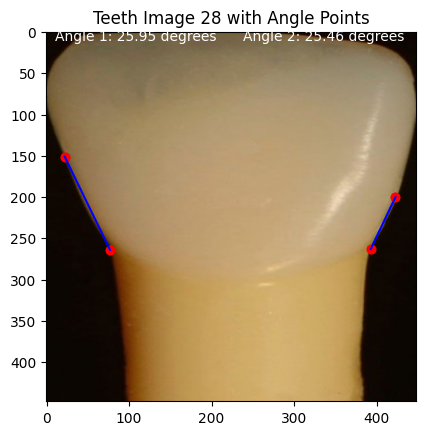

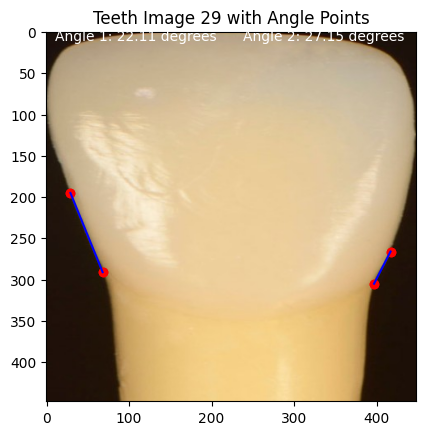

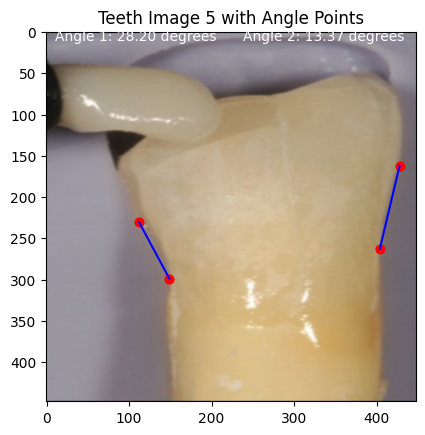

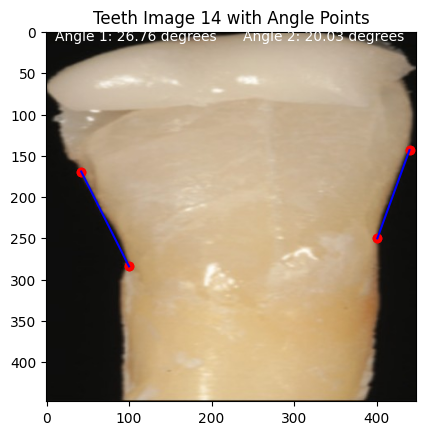

...

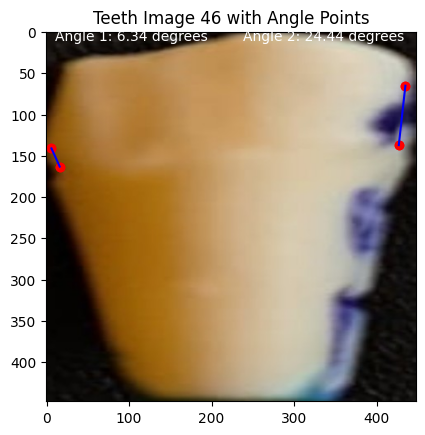

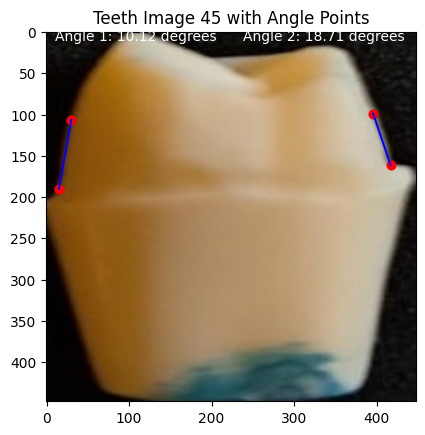

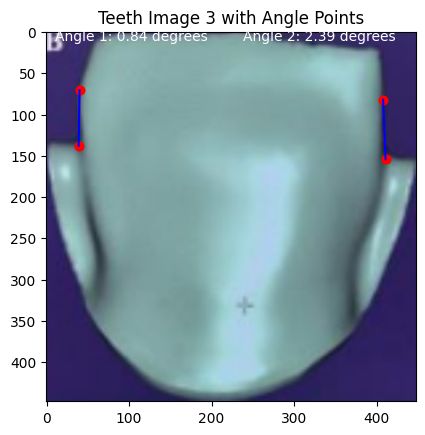

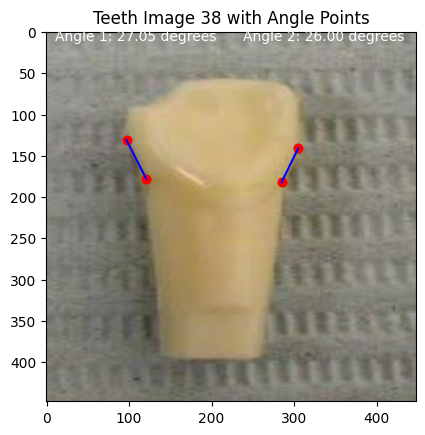

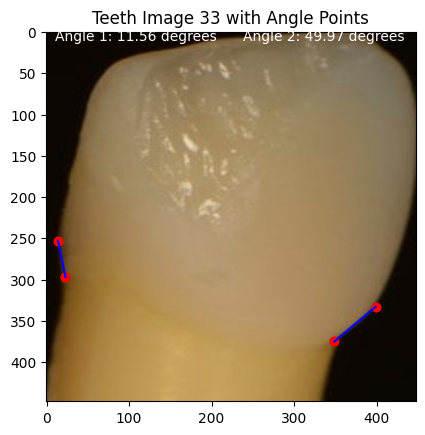

In [ ]:
import matplotlib.pyplot as plt
import cv2
import numpy as np

images = df.Image

# Visualize images and their corresponding angle points
for i in range(len(images)):
    image = cv2.imread(images[i])
    angle = [df.loc[i, f'coin_{x}'] for x in range(1, 5)]

    # Plot image with angle points
    plt.figure()
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    # Plot scatter points
    for p in angle:
        plt.scatter([p[0], p[1]], [p[2], p[3]], color='red')

    angs=[]

    # Draw lines between the angle points
    for j in [0,2]:
        x_coords = [angle[j][0], angle[j + 1][0]]  # x-coordinates
        y_coords = [angle[j][2], angle[j + 1][2]]  # y-coordinates
        plt.plot(x_coords, y_coords, color='blue')

        # Calculate angle between two lines
        # Define the starting points of the two lines
        line1_start = np.array([angle[j][0], angle[j][2]])
        line2_start = np.array([angle[j+1][0], 448])

        # Define the ending points of the two lines
        line1_end = np.array([angle[j+1][0], angle[j+1][2]])
        line2_end = np.array([angle[j+1][0], 0])

        # Calculate the direction vectors of the two lines
        line1_vector = line1_end - line1_start
        line2_vector = line2_end - line2_start

        dot_product = np.dot(line1_vector, line2_vector)
        magnitude_product = np.linalg.norm(line1_vector) * np.linalg.norm(line2_vector)
        angle_rad = np.arccos(dot_product / magnitude_product)
        angle_deg = np.degrees(angle_rad)
        angs.append(angle_deg)

    plt.title(f'Teeth Image {images[i][:-4]} with Angle Points')
    plt.text(10, 10, f'Angle 1: {angs[0]:.2f} degrees', color='white') if angs[0] < 180 else  plt.text(10, 10, f'Angle: {angs[0]-360:.2f} degrees', color='red')
    plt.text(238, 10, f'Angle 2: {angs[1]:.2f} degrees', color='white') if angs[1] < 180 else  plt.text(10, 10, f'Angle: {angs[1]-360:.2f} degrees', color='red')
    #df.loc[i, 'Angle 1'] = angs[0] if angs[0] < 180 else angs[0]-180
    #df.loc[i, 'Angle 2'] = angs[1] if angs[1] < 180 else angs[1]-180
    plt.show()

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Load images and masks
images = []
masks = []


for im in df.Image:
    mask_path = f'/content/est/mask_{im[:-4]}.jpg'

    image = cv2.imread(im)
    mask = cv2.imread(mask_path)

    images.append(image)
    masks.append(mask)

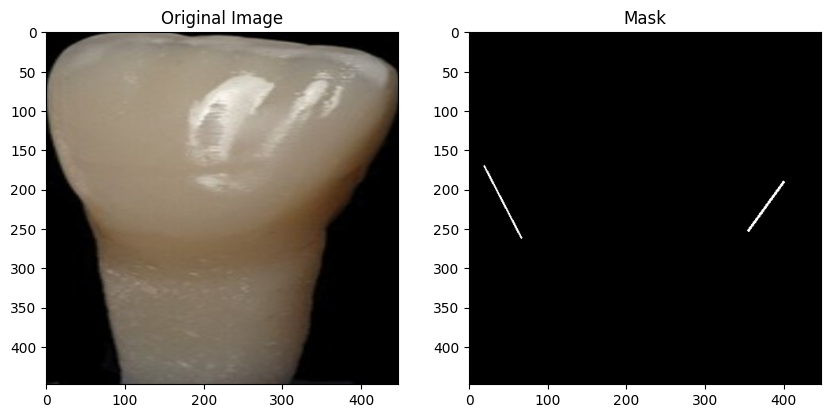

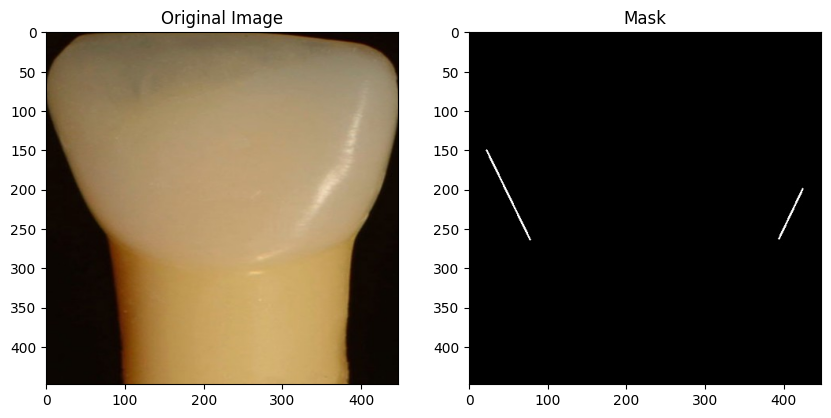

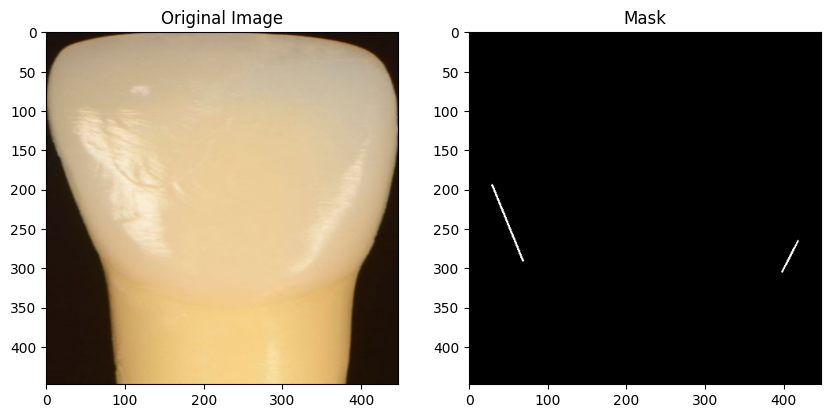

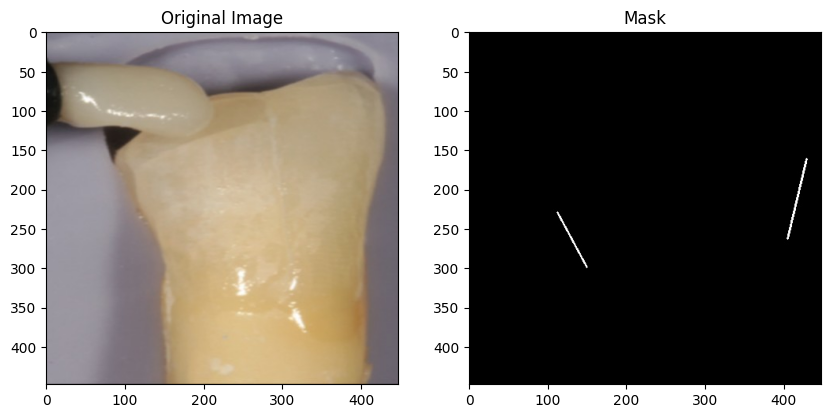

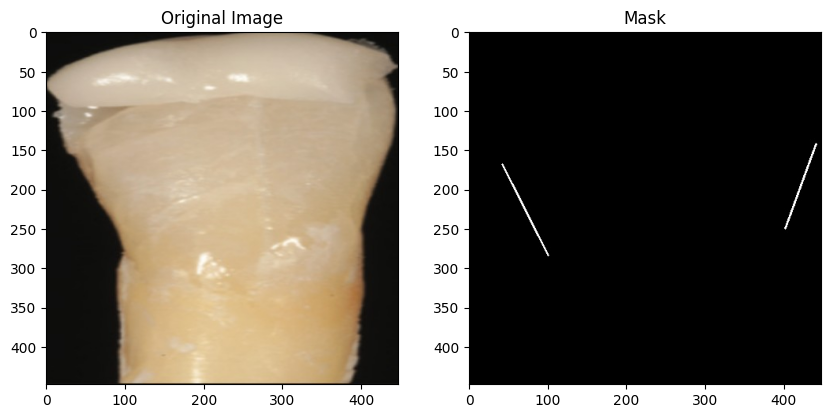

...

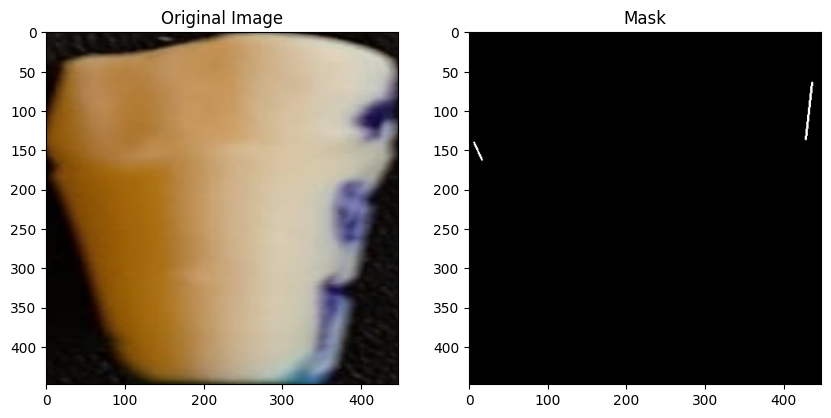

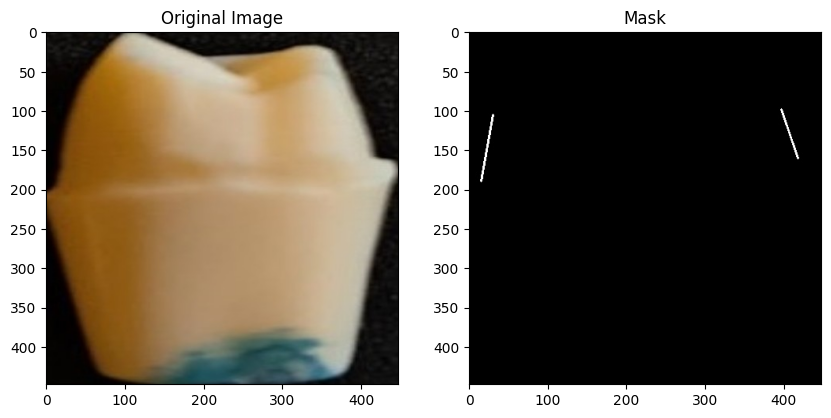

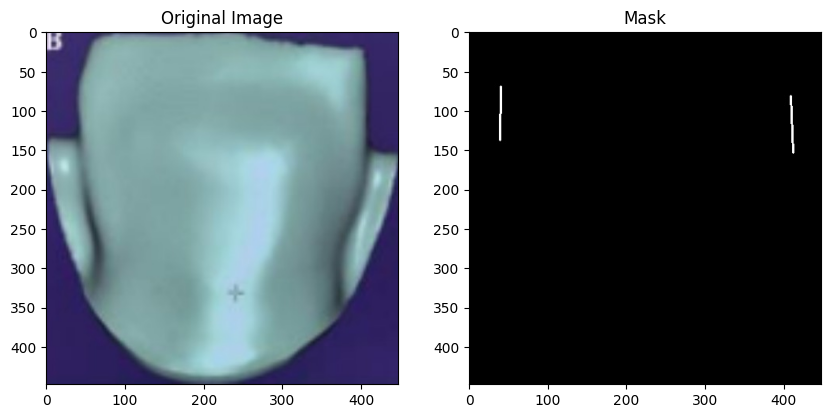

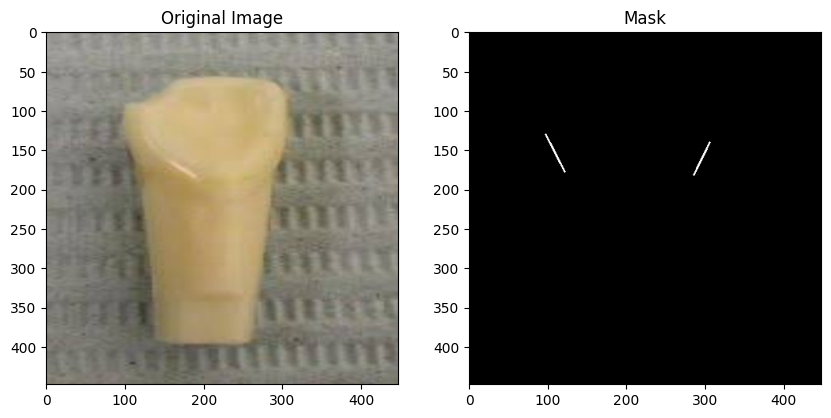

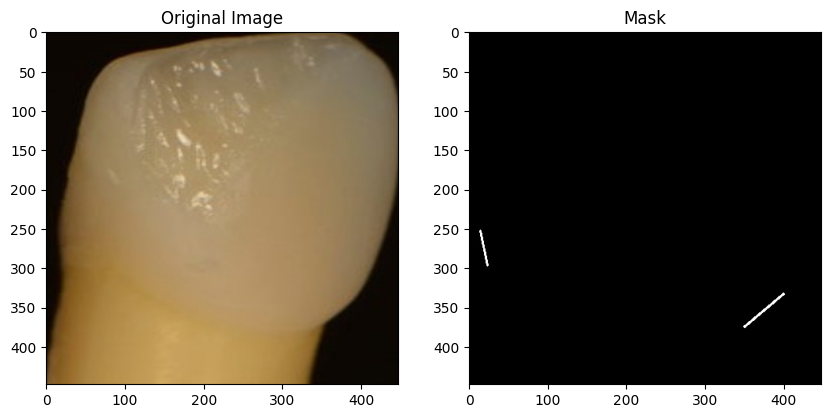

In [ ]:
# Display images and masks side by side
for image, mask in zip(images, masks):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Display the original image
    axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Image')

    # Display the mask
    axes[1].imshow(mask, cmap='gray')
    axes[1].set_title('Mask')

    plt.show()

In [ ]:
import tensorflow as tf
from tensorflow.image import resize

def rotate_image(image, angle):

  # Convert the image to float32.
  image = image.astype(np.float32)

  # Rotate the image.
  rotated_image = tf.image.rot90(image, k=angle // 90)

  # Convert the image back to uint8.
  rotated_image = rotated_image.astype(np.uint8)

  return rotated_image

def zoom_image(image, zoom_factor):

  # Convert the image to float32.
  image = image.astype(np.float32)

  # Zoom the image.
  zoomed_image = tf.image.resize(image, (int(image.shape[0] * zoom_factor), int(image.shape[1] * zoom_factor)))

  # Convert the image back to uint8.
  zoomed_image = zoomed_image.astype(np.uint8)

  return zoomed_image

# Create a list of rotation angles.
angles = np.linspace(0, 360, 3000)

# Create a list of zoom factors.
zoom_factors = np.linspace(0.5, 1.5, 500)

# Create an empty array to store the augmented images.
augmented_images =[]

# Iterate over the original images.
for i, image in enumerate(images):

  # Rotate the image.
  rotated_images = []
  for angle in angles:
    rotated_image = rotate_image(image, angle)
    rotated_images.append(rotated_image)

  # Zoom the image.
  zoomed_images = []
  for zoom_factor in zoom_factors:
    zoomed_image = zoom_image(image, zoom_factor)
    zoomed_images.append(zoomed_image)
  augmented_images[i] = augmented_images.append(np.concatenate([resize(image, (224, 224)) for image in rotated_images + zoomed_images], axis=0))

In [ ]:
from sklearn.model_selection import train_test_split


# Modify the masks to have a single channel
augmented_masks_single_channel = augmented_masks[..., 0:1]
# Split the augmented data into training and validation sets
train_images, val_images, train_masks, val_masks = train_test_split(augmented_images, augmented_masks_single_channel, test_size=0.2, random_state=42)

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Concatenate

def unet_model(input_shape):
    inputs = Input(input_shape)

    # Encoding path
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    # Add more convolutional and pooling layers as needed

    # Decoding path
    up6 = UpSampling2D(size=(2, 2))(pool1)
    merge6 = Concatenate(axis=3)([conv1, up6])
    conv6 = Conv2D(2, 3, activation='relu', padding='same')(merge6)
    # Add more upsampling and concatenation layers as needed

    # Output
    outputs = Conv2D(1, 1, activation='sigmoid')(conv6)

    model = Model(inputs=inputs, outputs=outputs)
    return model


# Build the U-Net model
input_shape = images[0].shape
model = unet_model(input_shape)

In [ ]:
# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy')
# Train the model
model.fit(train_images, train_masks, batch_size=8, epochs=10, validation_data=(val_images, val_masks))

Epoch 1/10
5/5 [==============================] - 67s 13s/step - loss: 0.6976 - val_loss: 0.6924
Epoch 2/10
5/5 [==============================] - 63s 13s/step - loss: 0.6918 - val_loss: 0.6917
Epoch 3/10
5/5 [==============================] - 65s 13s/step - loss: 0.6907 - val_loss: 0.6910
Epoch 4/10
5/5 [==============================] - 64s 13s/step - loss: 0.6899 - val_loss: 0.6904
Epoch 5/10
5/5 [==============================] - 63s 13s/step - loss: 0.6889 - val_loss: 0.6897
Epoch 6/10
5/5 [==============================] - 62s 12s/step - loss: 0.6879 - val_loss: 0.6890
Epoch 7/10
5/5 [==============================] - 62s 12s/step - loss: 0.6871 - val_loss: 0.6884
Epoch 8/10
5/5 [==============================] - 63s 12s/step - loss: 0.6861 - val_loss: 0.6877
Epoch 9/10
5/5 [==============================] - 61s 12s/step - loss: 0.6852 - val_loss: 0.6871
Epoch 10/10
5/5 [==============================] - 61s 12s/step - loss: 0.6842 - val_loss: 0.6864


In [ ]:
# Evaluate the model
eval_loss = model.evaluate(val_images, val_masks)
print("Evaluation Loss:", eval_loss)

1/1 [==============================] - 5s 5s/step - loss: 0.6864
Evaluation Loss: 0.6864137649536133


In [1]:
# Perform inference on new images
new_image_path = '3.jpg'
new_image = cv2.imread(new_image_path)

# Preprocess the new image
new_image = np.expand_dims(new_image, axis=0)

# Predict line mask
line_mask = model.predict(new_image)

# Threshold the line mask
threshold = 0.5
thresholded_mask = (line_mask > threshold).astype(np.uint8)

# Perform post-processing if needed (e.g., morphological operations or line fitting)

# Visualize the line mask
cv2.imshow("Line Mask", thresholded_mask[0] * 255)
cv2.waitKey(0)
cv2.destroyAllWindows()

NameError: name 'cv2' is not defined